In [1]:
import os
# arrange an instance segmentation model for test
from sahi.utils.yolov8 import (
    download_yolov8s_model, download_yolov8s_seg_model
)
from ultralytics import YOLO, RTDETR
from sahi import AutoDetectionModel
from sahi.utils.cv import read_image
from sahi.predict import get_prediction, get_sliced_prediction, predict
from IPython.display import Image
from matplotlib import pyplot as plt

import random
import cv2
import json
import os
from pycocotools.coco import COCO

### test 3 random images from test data

In [2]:
# Paths
COCO_JSON = "/home/sai/drone_ws/src/object_detect/cfg/coco_annotations.json"
TEST_DATA_PATH = "/home/sai/drone_ws/src/object_detect/data/VisImages/VisDrone2019-DET-test-dev/images"

# Load COCO annotations
coco = COCO(COCO_JSON)

# Select three random images
image_ids = coco.getImgIds()


loading annotations into memory...
Done (t=0.39s)
creating index...
index created!


In [3]:
# Generate a color map for the categories
categories = coco.loadCats(coco.getCatIds())
category_colors = {
    cat['id']: tuple(random.randint(0, 255) for _ in range(3)) for cat in categories
}

In [4]:
random_image_ids: list[int] = random.sample(image_ids, 3)

### get original annotations

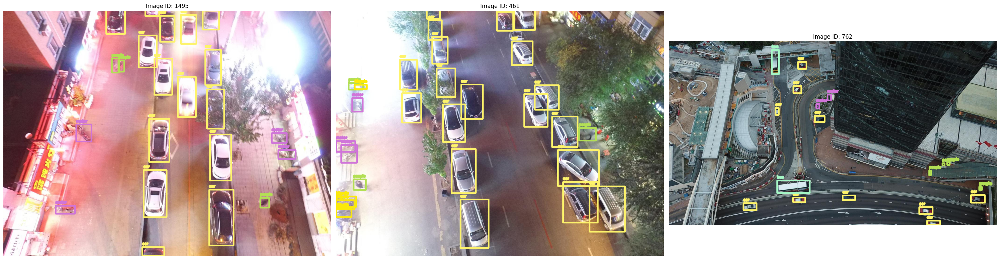

In [5]:
# Initialize a figure for plotting
fig, axes = plt.subplots(1, 3, figsize=(30, 30))

for i, image_id in enumerate(random_image_ids):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

    # Get annotations for the image
    annotation_ids = coco.getAnnIds(imgIds=image_id)
    annotations = coco.loadAnns(annotation_ids)

    # Plot bounding boxes
    for ann in annotations:
        x, y, w, h = ann['bbox']
        category_id = ann['category_id']
        category_name = coco.loadCats(category_id)[0]['name']
        color = category_colors[category_id]  # Get color for the category
        thickness = 5

        # Draw the bounding box
        cv2.rectangle(image, (int(x), int(y)), (int(x + w), int(y + h)), color, thickness)
        # Add label
        cv2.putText(
            image,
            category_name,
            (int(x), int(y) - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # Display image in the subplot
    axes[i].imshow(image)
    axes[i].axis("off")
    axes[i].set_title(f"Image ID: {image_id}")

# Adjust layout and display
plt.tight_layout()
plt.show()

### models path

In [6]:
YOLO11_MODEL_PATH = '/home/sai/drone_ws/src/object_detect/runs/detect/yolo11_800_16_200_coslr_dropout05/weights/best.pt'
YOLO8_MODEL_PATH ='/home/sai/drone_ws/src/object_detect/runs/detect/yolov8_800_16_200_coslr_dropout05/weights/best.pt'
RTDETR_MODEL_PATH = '/home/sai/drone_ws/src/object_detect/runs/detect/rtdetr_800_16_200_coslr_dropout05/weights/best.pt'

# Model configuration
models = {
    "YOLOv8": {
        "original": YOLO("yolov8s.pt"),
        "custom": YOLO(YOLO8_MODEL_PATH),
    },
    "YOLOv11": {
        "original": YOLO("yolo11s.pt"),
        "custom": YOLO(YOLO11_MODEL_PATH),
    },
    "RT-DETR": {
        "original": RTDETR("rtdetr-l.pt"),
        "custom": RTDETR(RTDETR_MODEL_PATH),
    },
}


In [7]:
# Helper function to process and plot images
def process_and_plot(image_id, model_name, original_model, custom_model, axes, row_idx):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Perform inference with both models
    original_preds = original_model.predict(image_path, conf=0.25, verbose=False)[0]
    custom_preds = custom_model.predict(image_path, conf=0.25, verbose=False)[0]

    # Plot original image with COCO annotations
    coco_annotations = coco.loadAnns(coco.getAnnIds(imgIds=image_id))
    annotated_image = image_rgb.copy()
    for ann in coco_annotations:
        x, y, w, h = ann['bbox']
        category_name = coco.loadCats(ann['category_id'])[0]['name']
        color = (0, 255, 0)  # Green for ground truth
        cv2.rectangle(annotated_image, (int(x), int(y)), (int(x + w), int(y + h)), color, 2)
        cv2.putText(annotated_image, category_name, (int(x), int(y) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Plot predictions from original model
    original_pred_image = image_rgb.copy()
    for box in original_preds.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        conf = box.conf[0]
        cls = int(box.cls[0])
        category_name = original_model.names[cls]
        color = (255, 0, 0)  # Blue for original model
        cv2.rectangle(original_pred_image, (x1, y1), (x2, y2), color, 2)
        cv2.putText(original_pred_image, f"{category_name} {conf:.2f}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Plot predictions from custom-trained model
    custom_pred_image = image_rgb.copy()
    for box in custom_preds.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        conf = box.conf[0]
        cls = int(box.cls[0])
        category_name = custom_model.names[cls]
        color = (0, 0, 255)  # Red for custom model
        cv2.rectangle(custom_pred_image, (x1, y1), (x2, y2), color, 2)
        cv2.putText(custom_pred_image, f"{category_name} {conf:.2f}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Display the three images
    axes[row_idx, 0].imshow(annotated_image)
    axes[row_idx, 0].set_title("Original Annotations")
    axes[row_idx, 0].axis("off")

    axes[row_idx, 1].imshow(original_pred_image)
    axes[row_idx, 1].set_title(f"Original {model_name}")
    axes[row_idx, 1].axis("off")

    axes[row_idx, 2].imshow(custom_pred_image)
    axes[row_idx, 2].set_title(f"Custom {model_name}")
    axes[row_idx, 2].axis("off")

### Test the default Yolov11 with the trained yolov11 model on visdrone dataset 

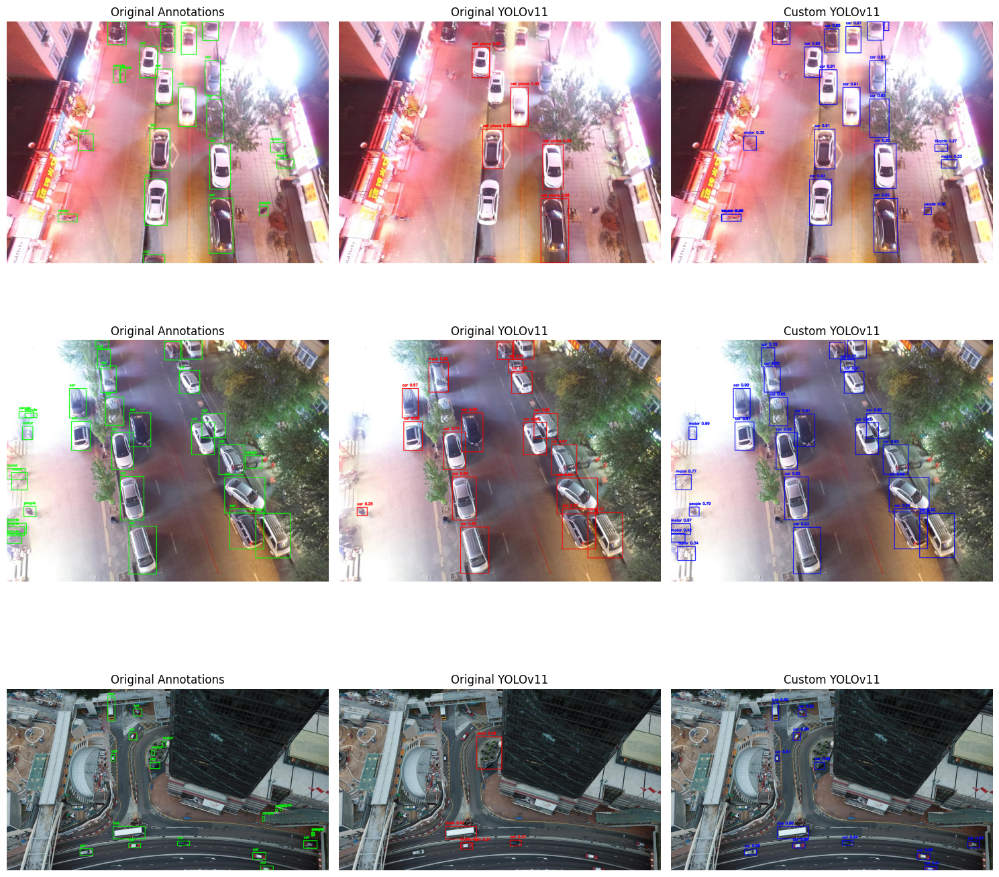

In [8]:
# Initialize a figure for plotting
fig, axes = plt.subplots(len(random_image_ids), 3, figsize=(15, 15))

# Iterate through models and images
for row_idx, image_id in enumerate(random_image_ids):
        process_and_plot(
            image_id,
            "YOLOv11",
            models["YOLOv11"]["original"],
            models["YOLOv11"]["custom"],
            axes,
            row_idx
        )

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

### Test the default Yolov8 with the trained yolov8 model on visdrone dataset 

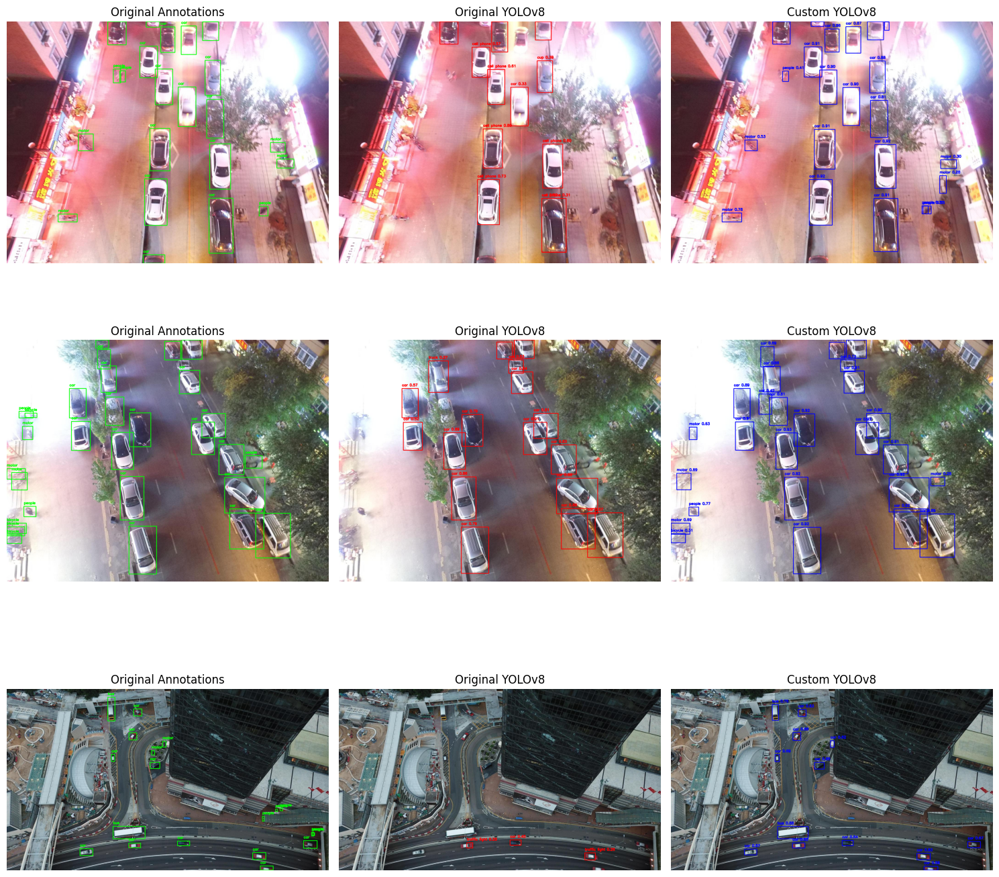

In [9]:
# Initialize a figure for plotting
fig, axes = plt.subplots(len(random_image_ids), 3, figsize=(15, 15))

# Iterate through models and images
for row_idx, image_id in enumerate(random_image_ids):
        process_and_plot(
            image_id,
            "YOLOv8",
            models["YOLOv8"]["original"],
            models["YOLOv8"]["custom"],
            axes,
            row_idx
        )

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

### Test the default RT-DETR with the trained RT-DETR model on visdrone dataset 

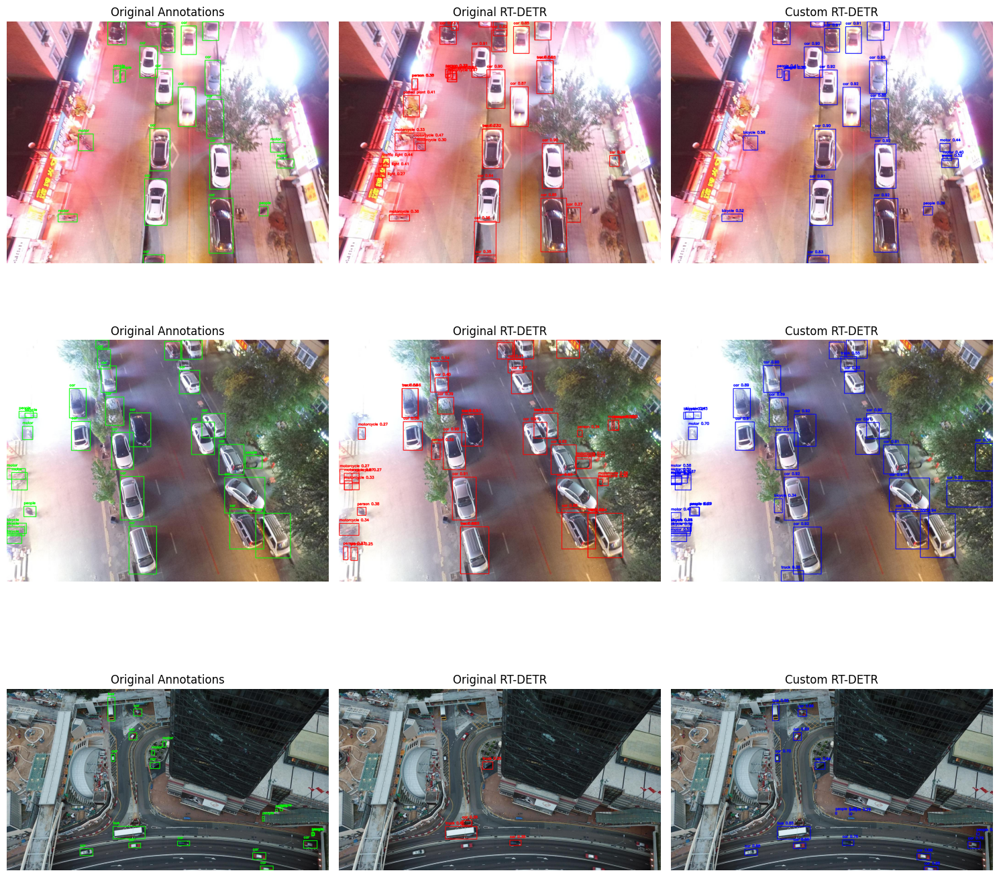

In [10]:
# Initialize a figure for plotting
fig, axes = plt.subplots(len(random_image_ids), 3, figsize=(15, 15))

# Iterate through models and images
for row_idx, image_id in enumerate(random_image_ids):
        process_and_plot(
            image_id,
            "RT-DETR",
            models["RT-DETR"]["original"],
            models["RT-DETR"]["custom"],
            axes,
            row_idx
        )

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

### Yolov11 vs yolov8 vs RT-DETR

In [18]:
# Helper function to process and plot images
def process_and_plot_custom(image_id, model_name, custom_model, axes):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Perform inference with the custom model
    custom_preds = custom_model.predict(image_path, conf=0.25, verbose=False)[0]

    # Plot predictions from custom-trained model
    custom_pred_image = image_rgb.copy()
    for box in custom_preds.boxes:
        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        conf = box.conf[0]
        cls = int(box.cls[0])
        category_name = custom_model.names[cls]
        color = (0, 0, 255)  # Red for custom model
        cv2.rectangle(custom_pred_image, (x1, y1), (x2, y2), color, 2)
        cv2.putText(custom_pred_image, f"{category_name} {conf:.2f}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

    # Display the custom model's predictions
    axes.imshow(custom_pred_image)
    axes.set_title(f"Custom {model_name}")
    axes.axis("off")

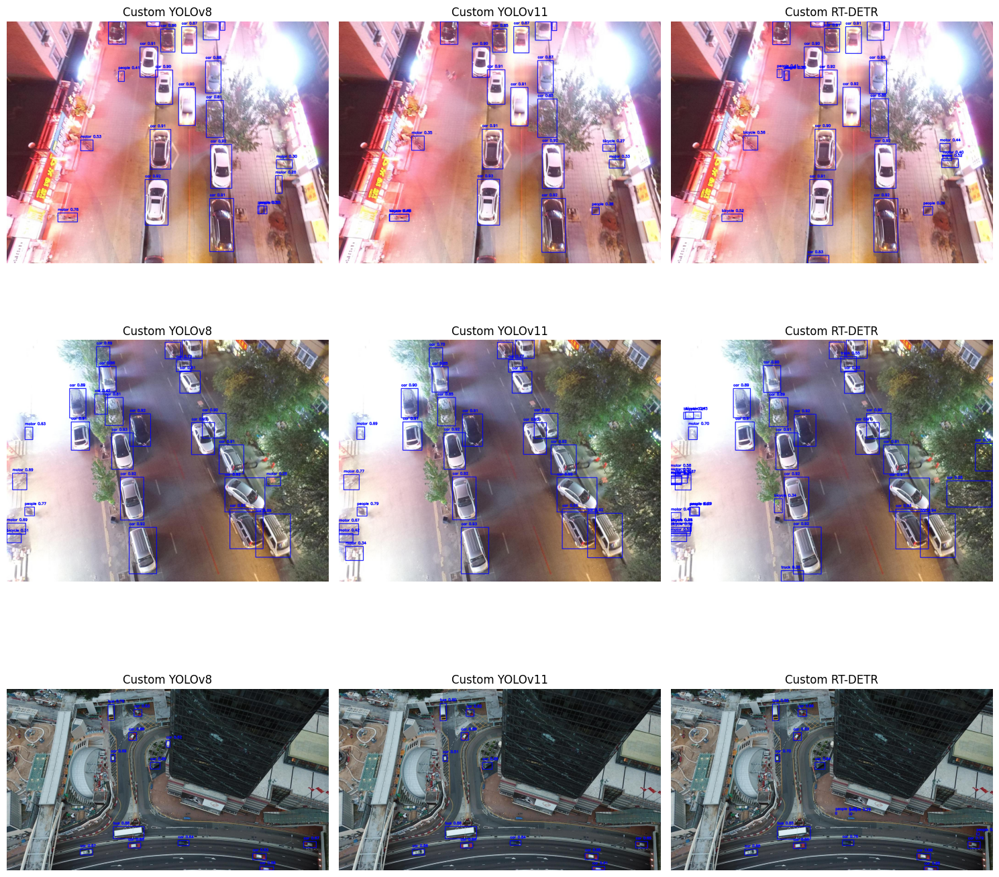

In [20]:
# Initialize a figure for plotting
fig, axes = plt.subplots(len(random_image_ids), len(models), figsize=(15, 5 * len(random_image_ids)))

# Ensure axes is always a 2D array
if len(random_image_ids) == 1:
    axes = [axes]
if len(models) == 1:
    axes = [[ax] for ax in axes]

# Iterate through models and images
for row_idx, image_id in enumerate(random_image_ids):
    for col_idx, (model_name, model_data) in enumerate(models.items()):
        process_and_plot_custom(
            image_id,
            model_name,
            models[model_name]["custom"],
            axes[row_idx][col_idx]
        )

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

### SAHI vs yolov11

Performing prediction on 6 slices.
Performing prediction on 6 slices.


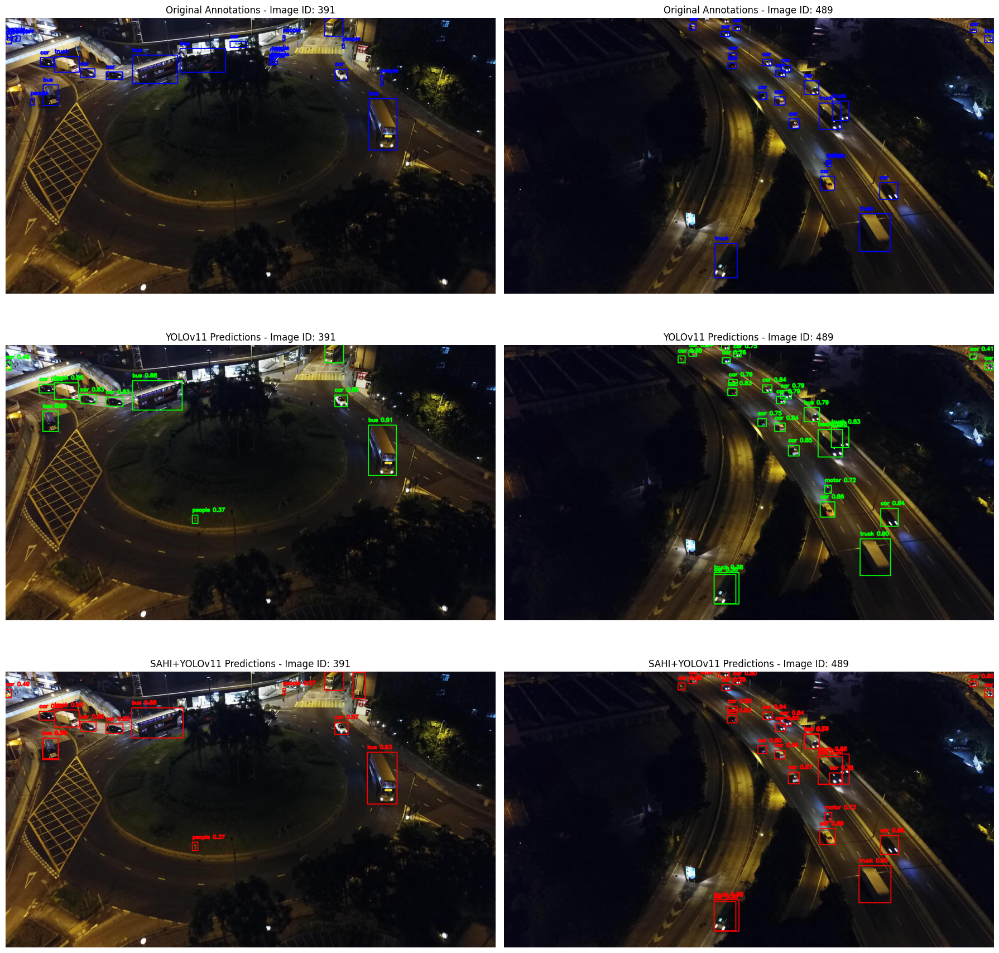

In [23]:
# Load YOLOv11 model
detection_model = AutoDetectionModel.from_pretrained(
    model_type="yolov8",
    model_path='/home/sai/drone_ws/src/object_detect/runs/detect/yolo11_800_16_200_coslr_dropout05/weights/best.pt',
    confidence_threshold=0.3,
    device="cuda:0"  # Change to "cpu" if GPU is not available
)

# Select three random images
image_ids = coco.getImgIds()
random_image_ids = random.sample(image_ids, 2)

# Initialize a figure for plotting
fig, axes = plt.subplots(3, 2, figsize=(18, 18))

for i, image_id in enumerate(random_image_ids):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

    # Original annotations
    original_image = image.copy()
    annotation_ids = coco.getAnnIds(imgIds=image_id)
    annotations = coco.loadAnns(annotation_ids)
    for ann in annotations:
        x, y, w, h = ann['bbox']
        category_name = coco.loadCats(ann['category_id'])[0]['name']
        color = (0, 0, 255)  # Blue color for original annotations
        thickness = 2
        cv2.rectangle(original_image, (int(x), int(y)), (int(x + w), int(y + h)), color, thickness)
        cv2.putText(
            original_image,
            category_name,
            (int(x), int(y) - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # YOLOv11 predictions
    yolov11_result = get_prediction(image_path, detection_model=detection_model)
    yolov11_image = image.copy()
    for pred in yolov11_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (0, 255, 0)  # Green color for YOLOv8 predictions
        thickness = 2
        cv2.rectangle(yolov11_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            yolov11_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # SAHI-enhanced YOLOv11 predictions
    sahi_result = get_sliced_prediction(image_path,
        detection_model=detection_model,
        slice_height=720,
        slice_width=720,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2,
    )
    sahi_image = image.copy()
    for pred in sahi_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (255, 0, 0)  # Red color for SAHI+YOLOv8 predictions
        thickness = 2
        cv2.rectangle(sahi_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            sahi_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # Display Original Annotations
    axes[0, i].imshow(original_image)
    axes[0, i].axis("off")
    axes[0, i].set_title(f"Original Annotations - Image ID: {image_id}")

    # Display YOLOv8 predictions
    axes[1, i].imshow(yolov11_image)
    axes[1, i].axis("off")
    axes[1, i].set_title(f"YOLOv11 Predictions - Image ID: {image_id}")

    # Display SAHI+YOLOv8 predictions
    axes[2, i].imshow(sahi_image)
    axes[2, i].axis("off")
    axes[2, i].set_title(f"SAHI+YOLOv11 Predictions - Image ID: {image_id}")

# Adjust layout and display
plt.tight_layout()
plt.show()

### SAHI vs yolov8

Performing prediction on 6 slices.
Performing prediction on 6 slices.
Performing prediction on 6 slices.


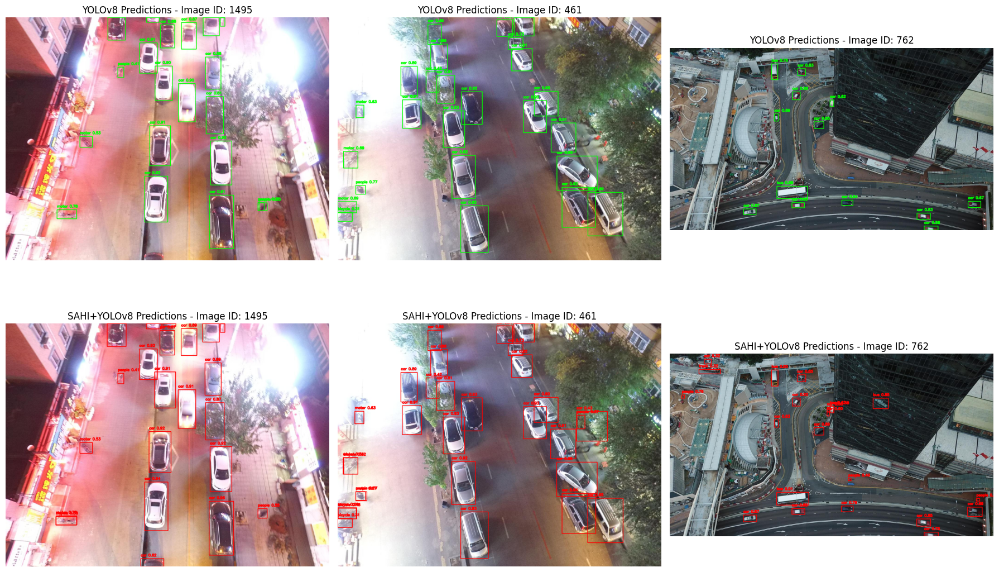

In [22]:
# Load YOLOv8 model
detection_model = AutoDetectionModel.from_pretrained(
    model_type="yolov8",
    model_path='/home/sai/drone_ws/src/object_detect/runs/detect/yolov8_800_16_200_coslr_dropout05/weights/best.pt',
    confidence_threshold=0.3,
    device="cuda:0"
)

fig, axes = plt.subplots(2, 3, figsize=(18, 12))

for i, image_id in enumerate(random_image_ids):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

    # YOLOv8 predictions
    yolov8_result = get_prediction(image_path, detection_model=detection_model)
    yolov8_image = image.copy()
    for pred in yolov8_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (0, 255, 0)  # Green color for bounding boxes
        thickness = 2
        cv2.rectangle(yolov8_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            yolov8_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # SAHI-enhanced YOLOv8 predictions
    sahi_result = get_sliced_prediction(image_path,
        detection_model=detection_model,
        slice_height=720,
        slice_width=720,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2,
    )
    sahi_image = image.copy()
    for pred in sahi_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (255, 0, 0)  # Red color for bounding boxes
        thickness = 2
        cv2.rectangle(sahi_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            sahi_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # Display YOLOv8 predictions
    axes[0, i].imshow(yolov8_image)
    axes[0, i].axis("off")
    axes[0, i].set_title(f"YOLOv8 Predictions - Image ID: {image_id}")

    # Display SAHI+YOLOv8 predictions
    axes[1, i].imshow(sahi_image)
    axes[1, i].axis("off")
    axes[1, i].set_title(f"SAHI+YOLOv8 Predictions - Image ID: {image_id}")

# Adjust layout and display
plt.tight_layout()
plt.show()

### SAHI vs RT-DETR

Performing prediction on 6 slices.
Performing prediction on 6 slices.


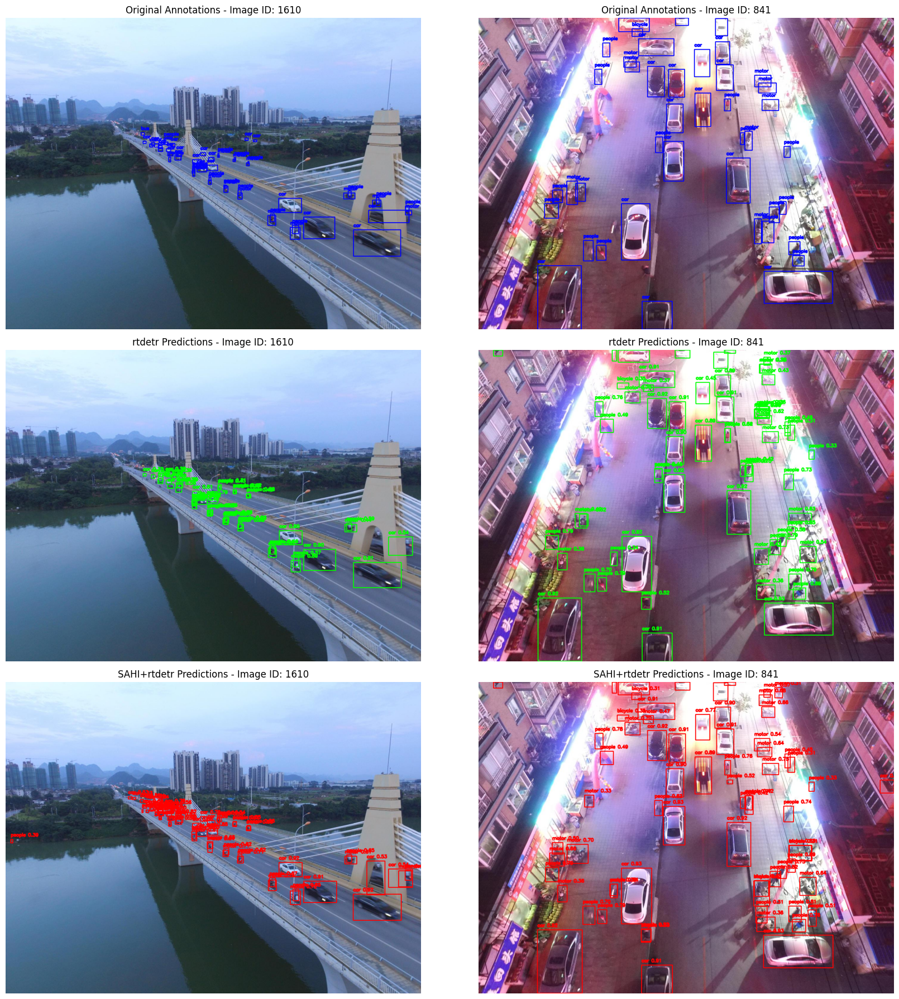

In [24]:
# Load YOLOv11 model
detection_model = AutoDetectionModel.from_pretrained(
    model_type="rtdetr",
    model_path='/home/sai/drone_ws/src/object_detect/runs/detect/rtdetr_800_16_200_coslr_dropout05/weights/best.pt',
    confidence_threshold=0.3,
    device="cuda:0"  # Change to "cpu" if GPU is not available
)

# Select three random images
image_ids = coco.getImgIds()
random_image_ids = random.sample(image_ids, 2)

# Initialize a figure for plotting
fig, axes = plt.subplots(3, 2, figsize=(18, 18))

for i, image_id in enumerate(random_image_ids):
    # Get image details
    image_info = coco.loadImgs(image_id)[0]
    image_path = os.path.join(TEST_DATA_PATH, image_info['file_name'])
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert to RGB for Matplotlib

    # Original annotations
    original_image = image.copy()
    annotation_ids = coco.getAnnIds(imgIds=image_id)
    annotations = coco.loadAnns(annotation_ids)
    for ann in annotations:
        x, y, w, h = ann['bbox']
        category_name = coco.loadCats(ann['category_id'])[0]['name']
        color = (0, 0, 255)  # Blue color for original annotations
        thickness = 2
        cv2.rectangle(original_image, (int(x), int(y)), (int(x + w), int(y + h)), color, thickness)
        cv2.putText(
            original_image,
            category_name,
            (int(x), int(y) - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    rtdetr_result = get_prediction(image_path, detection_model=detection_model)
    rtdetr_image = image.copy()
    for pred in rtdetr_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (0, 255, 0)  # Green color for YOLOv8 predictions
        thickness = 2
        cv2.rectangle(rtdetr_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            rtdetr_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # SAHI-enhanced rtdetr predictions
    sahi_result = get_sliced_prediction(image_path,
        detection_model=detection_model,
        slice_height=720,
        slice_width=720,
        overlap_height_ratio=0.2,
        overlap_width_ratio=0.2,
    )
    sahi_image = image.copy()
    for pred in sahi_result.object_prediction_list:
        x1, y1, x2, y2 = int(pred.bbox.minx), int(pred.bbox.miny), int(pred.bbox.maxx), int(pred.bbox.maxy)
        score = pred.score.value
        category_name = pred.category.name
        color = (255, 0, 0)  # Red color for SAHI+YOLOv8 predictions
        thickness = 2
        cv2.rectangle(sahi_image, (x1, y1), (x2, y2), color, thickness)
        cv2.putText(
            sahi_image,
            f"{category_name} {score:.2f}",
            (x1, y1 - 10),
            cv2.FONT_HERSHEY_SIMPLEX,
            0.5,
            color,
            thickness,
            cv2.LINE_AA,
        )

    # Display Original Annotations
    axes[0, i].imshow(original_image)
    axes[0, i].axis("off")
    axes[0, i].set_title(f"Original Annotations - Image ID: {image_id}")

    # Display rtdetr predictions
    axes[1, i].imshow(rtdetr_image)
    axes[1, i].axis("off")
    axes[1, i].set_title(f"rtdetr Predictions - Image ID: {image_id}")

    # Display SAHI+YOLOv8 predictions
    axes[2, i].imshow(sahi_image)
    axes[2, i].axis("off")
    axes[2, i].set_title(f"SAHI+rtdetr Predictions - Image ID: {image_id}")

# Adjust layout and display
plt.tight_layout()
plt.show()